<a href="https://colab.research.google.com/github/sofienmeftahi/-WhatsApp-Batch-Messenger/blob/main/Network_Traffic_dashboard.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [76]:
from IPython.display import HTML, display

title_html = """
<div style="text-align: center; margin-top: 20px; margin-bottom: 20px;">
  <h1 style="
      color: red;
      font-size: 56px;
      font-family: 'Arial', sans-serif;
      font-weight: 700;
      letter-spacing: 1px;
      margin: 0;
  ">
    Comprehensive Network Traffic Analysis Dashboard
  </h1>

</div>
"""
display(HTML(title_html))


In [ ]:
import pandas as pd


df = pd.read_csv("Darknet.csv")

df.head()


,Flow ID,Src IP,Src Port,Dst IP,Dst Port,Protocol,Timestamp,Flow Duration,Total Fwd Packet,Total Bwd packets,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label,Label.1
0,10.152.152.11-216.58.220.99-57158-443-6,10.152.152.11,57158,216.58.220.99,443,6,24/07/2015 04:09:48 PM,229,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
1,10.152.152.11-216.58.220.99-57159-443-6,10.152.152.11,57159,216.58.220.99,443,6,24/07/2015 04:09:48 PM,407,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
2,10.152.152.11-216.58.220.99-57160-443-6,10.152.152.11,57160,216.58.220.99,443,6,24/07/2015 04:09:48 PM,431,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
3,10.152.152.11-74.125.136.120-49134-443-6,10.152.152.11,49134,74.125.136.120,443,6,24/07/2015 04:09:48 PM,359,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
4,10.152.152.11-173.194.65.127-34697-19305-6,10.152.152.11,34697,173.194.65.127,19305,6,24/07/2015 04:09:45 PM,10778451,591,400,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,Non-Tor,AUDIO-STREAMING


In [ ]:
print("Number of rows and columns:", df.shape)
print("\nColumn names:\n", df.columns.tolist())


Number of rows and columns: (158616, 85)

Column names:
 ['Flow ID', 'Src IP', 'Src Port', 'Dst IP', 'Dst Port', 'Protocol', 'Timestamp', 'Flow Duration', 'Total Fwd Packet', 'Total Bwd packets', 'Total Length of Fwd Packet', 'Total Length of Bwd Packet', 'Fwd Packet Length Max', 'Fwd Packet Length Min', 'Fwd Packet Length Mean', 'Fwd Packet Length Std', 'Bwd Packet Length Max', 'Bwd Packet Length Min', 'Bwd Packet Length Mean', 'Bwd Packet Length Std', 'Flow Bytes/s', 'Flow Packets/s', 'Flow IAT Mean', 'Flow IAT Std', 'Flow IAT Max', 'Flow IAT Min', 'Fwd IAT Total', 'Fwd IAT Mean', 'Fwd IAT Std', 'Fwd IAT Max', 'Fwd IAT Min', 'Bwd IAT Total', 'Bwd IAT Mean', 'Bwd IAT Std', 'Bwd IAT Max', 'Bwd IAT Min', 'Fwd PSH Flags', 'Bwd PSH Flags', 'Fwd URG Flags', 'Bwd URG Flags', 'Fwd Header Length', 'Bwd Header Length', 'Fwd Packets/s', 'Bwd Packets/s', 'Packet Length Min', 'Packet Length Max', 'Packet Length Mean', 'Packet Length Std', 'Packet Length Variance', 'FIN Flag Count', 'SYN Flag Coun

In [ ]:
df.info()
df.isnull().sum().sort_values(ascending=False).head(20)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158616 entries, 0 to 158615
Data columns (total 85 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Flow ID                     158616 non-null  object 
 1   Src IP                      158616 non-null  object 
 2   Src Port                    158616 non-null  int64  
 3   Dst IP                      158616 non-null  object 
 4   Dst Port                    158616 non-null  int64  
 5   Protocol                    158616 non-null  int64  
 6   Timestamp                   158616 non-null  object 
 7   Flow Duration               158616 non-null  int64  
 8   Total Fwd Packet            158616 non-null  int64  
 9   Total Bwd packets           158616 non-null  int64  
 10  Total Length of Fwd Packet  158616 non-null  int64  
 11  Total Length of Bwd Packet  158616 non-null  int64  
 12  Fwd Packet Length Max       158616 non-null  int64  
 13  Fwd Packet Len

,0
Flow Bytes/s,48
Src IP,0
Src Port,0
Dst IP,0
Flow ID,0
Dst Port,0
Protocol,0
Flow Duration,0
Timestamp,0
Total Bwd packets,0


In [ ]:
import pandas as pd

# Keep only the important columns
cols_to_keep = [
    'Src IP', 'Dst IP', 'Protocol', 'Flow Duration',
    'Total Fwd Packet', 'Total Bwd packets', 'Flow Bytes/s',
    'Flow Packets/s', 'Packet Length Mean', 'Packet Length Std',
    'Label', 'Label.1', 'Timestamp'
]

df_small = df[cols_to_keep].copy()

# Convert time to a proper datetime format
df_small['Timestamp'] = pd.to_datetime(df_small['Timestamp'], errors='coerce')

# Remove missing values
df_small.dropna(inplace=True)

# Rename the column Label.1 to make it clearer
df_small.rename(columns={'Label.1': 'Traffic_Type'}, inplace=True)

df_small.head()


/tmp/ipython-input-522323637.py:14: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



,Src IP,Dst IP,Protocol,Flow Duration,Total Fwd Packet,Total Bwd packets,Flow Bytes/s,Flow Packets/s,Packet Length Mean,Packet Length Std,Label,Traffic_Type,Timestamp
0,10.152.152.11,216.58.220.99,6,229,1,1,0.00000,8733.624454,0.000000,0.00000,Non-Tor,AUDIO-STREAMING,2015-07-24 16:09:48
1,10.152.152.11,216.58.220.99,6,407,1,1,0.00000,4914.004914,0.000000,0.00000,Non-Tor,AUDIO-STREAMING,2015-07-24 16:09:48
2,10.152.152.11,216.58.220.99,6,431,1,1,0.00000,4640.371230,0.000000,0.00000,Non-Tor,AUDIO-STREAMING,2015-07-24 16:09:48
3,10.152.152.11,74.125.136.120,6,359,1,1,0.00000,5571.030641,0.000000,0.00000,Non-Tor,AUDIO-STREAMING,2015-07-24 16:09:48
4,10.152.152.11,173.194.65.127,6,10778451,591,400,6604.75239,91.942711,71.876008,56.93647,Non-Tor,AUDIO-STREAMING,2015-07-24 16:09:45


In [ ]:
print("🌐 Connection types:")
print(df_small['Label'].value_counts(), '\n')

print("📡 Activity types:")
print(df_small['Traffic_Type'].value_counts())


🌐 Connection types:
Label
Non-Tor    110396
NonVPN      23861
VPN         22919
Tor          1392
Name: count, dtype: int64 

📡 Activity types:
Traffic_Type
P2P                48520
Browsing           46457
Audio-Streaming    19830
Chat               11623
File-Transfer      11090
Video-Streaming     9468
Email               6143
VOIP                3566
AUDIO-STREAMING     1506
Video-streaming      281
File-transfer         84
Name: count, dtype: int64


In [ ]:
import plotly.express as px

# Group by minute
df_small['Minute'] = df_small['Timestamp'].dt.floor('T')
traffic_over_time = df_small.groupby('Minute').size().reset_index(name='Count')

fig1 = px.line(
    traffic_over_time,
    x='Minute', y='Count',
    title='📈 Network traffic evolution over time',
    markers=True
)
fig1.show()


/tmp/ipython-input-1659603181.py:4: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.



In [ ]:
import plotly.express as px

# 🔹 Protocol map (numbers → names)
protocol_map = {
    0: "HOPOPT",
    1: "ICMP",
    2: "IGMP",
    6: "TCP",
    8: "EGP",
    9: "IGP",
    17: "UDP",
    41: "IPv6",
    47: "GRE",
    50: "ESP",
    51: "AH",
    58: "ICMPv6",
    89: "OSPF",
    132: "SCTP"
}

# 🔹 Add a new column with protocol names
df_small['Protocol_Name'] = df_small['Protocol'].map(protocol_map).fillna("Other")

# 🔹 Scatter plot with the same previous format
fig2 = px.scatter(
    df_small,
    x='Flow Bytes/s',
    y='Flow Packets/s',
    size='Flow Duration',
    color='Protocol_Name',
    hover_data=['Traffic_Type'],
    title='🌐 Relationship between throughput and packet count by protocol (log scale)',
    size_max=12,
    log_x=True,
    log_y=True,
    color_discrete_sequence=px.colors.qualitative.Dark24  # Beautiful distinctive colors
)

# 🔹 Improve design
fig2.update_layout(
    plot_bgcolor='white',
    paper_bgcolor='white',
    title_font=dict(size=20, family='Arial', color='black'),
    font=dict(size=12),
    xaxis=dict(
        title='Throughput (Flow Bytes/s)',
        gridcolor='lightgray',
        showline=True,
        linecolor='black'
    ),
    yaxis=dict(
        title='Packet count (Flow Packets/s)',
        gridcolor='lightgray',
        showline=True,
        linecolor='black'
    ),
    legend_title_text='Protocol'
)

fig2.update_traces(marker=dict(line=dict(width=0.5, color='white'), opacity=0.7))
fig2.show()


In [ ]:
summary = (
    df_small.groupby('Traffic_Type')[['Flow Bytes/s', 'Flow Packets/s']]
    .mean()
    .round(2)
)
summary


,Flow Bytes/s,Flow Packets/s
Traffic_Type,,
AUDIO-STREAMING,17039.79,16847.76
Audio-Streaming,275557.69,5132.29
Browsing,17980.47,23962.17
Chat,123463.82,5958.12
Email,24428.48,5096.50
File-Transfer,inf,inf
File-transfer,89589.86,11577.19
P2P,2912.07,5990.93
VOIP,15454.70,1387.65


In [ ]:
df_small['Traffic_Type'] = df_small['Traffic_Type'].str.lower().str.strip().str.replace('_', '-')


In [ ]:
import plotly.express as px
import pandas as pd

# 🔹 Protocol conversion map (protocol numbers → protocol names)
protocol_map = {
    0: "HOPOPT",
    1: "ICMP",
    2: "IGMP",
    6: "TCP",
    8: "EGP",
    9: "IGP",
    17: "UDP",
    41: "IPv6",
    47: "GRE",
    50: "ESP",
    51: "AH",
    58: "ICMPv6",
    89: "OSPF",
    132: "SCTP"
}

# 🔹 Replace protocol numbers with names (if not found, keep it as "Other")
df_small['Protocol_Name'] = df_small['Protocol'].map(protocol_map).fillna("Other")

# 🔹 Count protocols by traffic type
protocol_counts = df_small.groupby(['Traffic_Type', 'Protocol_Name']).size().reset_index(name='Count')

# 🔹 Calculate the percentage of each protocol within each traffic type
protocol_counts['Pourcentage'] = protocol_counts.groupby('Traffic_Type')['Count'].transform(lambda x: 100 * x / x.sum())

# 🔹 Create a beautiful bar chart 🎨
fig = px.bar(
    protocol_counts,
    x='Traffic_Type',
    y='Pourcentage',
    color='Protocol_Name',
    title='📊 Percentage distribution of protocols by traffic type',
    text=protocol_counts['Pourcentage'].round(1).astype(str) + '%'
)

fig.update_layout(
    xaxis_title="Traffic Type",
    yaxis_title="Percentage (%)",
    xaxis_tickangle=45,
    bargap=0.3,
    barmode='stack'  # Each traffic type = 100%
)

fig.show()


In [ ]:
import plotly.express as px

# Distribution of activity types
traffic_counts = df_small['Traffic_Type'].value_counts().reset_index()
traffic_counts.columns = ['Traffic_Type', 'Count']  # Clearly name the columns

fig1 = px.bar(
    traffic_counts,
    x='Traffic_Type',
    y='Count',
    title="Distribution of Traffic Types",
    labels={'Traffic_Type': 'Traffic Type', 'Count': 'Number of Flows'},
    color='Traffic_Type'
)
fig1.show()

# Comparison between Tor and Non-Tor traffic
fig2 = px.pie(df_small, names='Label', title="Tor vs Non-Tor Traffic")
fig2.show()


In [ ]:
import plotly.express as px

# Keep only the four required types
df_filtered = df_small[df_small['Label'].isin(['VPN', 'NonVPN', 'Tor', 'Non-Tor'])].copy()

# Count each traffic type within each category
traffic_stats = df_filtered.groupby(['Label', 'Traffic_Type']).size().reset_index(name='Count')

# Plot the bar chart
fig = px.bar(
    traffic_stats,
    x='Traffic_Type',
    y='Count',
    color='Label',
    barmode='group',
    title="🌍 Distribution of traffic types between VPN, Non-VPN, Tor and Non-Tor",
    color_discrete_sequence=['#1F77B4', '#FF7F0E', '#2CA02C', '#D62728']  # Different colors
)

fig.update_layout(
    plot_bgcolor='white',
    paper_bgcolor='white',
    xaxis_title='Traffic Type',
    yaxis_title='Number of Flows',
    title_font=dict(size=20, family='Arial', color='black'),
    font=dict(size=12),
    xaxis=dict(tickangle=45, showline=True, linecolor='black'),
    yaxis=dict(showline=True, linecolor='black'),
    legend_title_text='Connection'
)

fig.update_traces(marker=dict(line=dict(width=0.3, color='white')))
fig.show()


In [ ]:
import plotly.graph_objects as go

fig3 = go.Figure()

fig3.add_trace(go.Indicator(
    mode="number",
    value=df_small.shape[0],
    title={"text": "Total Flows"}
))
fig3.add_trace(go.Indicator(
    mode="number",
    value=df_small['Src IP'].nunique(),
    title={"text": "Unique Source IPs"},
    domain={'x': [0, 0.5], 'y': [0, 0.5]}
))
fig3.add_trace(go.Indicator(
    mode="number",
    value=df_small['Dst IP'].nunique(),
    title={"text": "Unique Destination IPs"},
    domain={'x': [0.5, 1], 'y': [0.5, 1]}
))

fig3.update_layout(title="📊 General Network Traffic Statistics")
fig3.show()

In [ ]:
import plotly.express as px

# Protocol conversion map (optional)
protocol_map = {
    1: 'ICMP',
    2: 'IGMP',
    6: 'TCP',
    17: 'UDP',
    0: 'HOPOPT'
}

# Count the occurrences of each protocol
protocol_counts = df_small['Protocol'].value_counts().reset_index()
protocol_counts.columns = ['Protocol_Number', 'Count']

# Add a column for the protocol name (if in the map)
protocol_counts['Protocol_Name'] = protocol_counts['Protocol_Number'].map(protocol_map)
protocol_counts['Label'] = protocol_counts.apply(
    lambda row: f"{row['Protocol_Number']} ({row['Protocol_Name']})" if pd.notna(row['Protocol_Name']) else str(row['Protocol_Number']),
    axis=1
)

# Plot the bar chart with original numbers
fig4 = px.bar(
    protocol_counts.sort_values(by='Protocol_Number'),
    x='Label',
    y='Count',
    title="📡 Frequency of Network Protocols (CICDarknet2020)",
    color='Count',
    color_continuous_scale='Viridis'
)

fig4.update_layout(
    xaxis_title="Protocol (Number and Name)",
    yaxis_title="Number of occurrences",
    xaxis={'categoryorder':'array', 'categoryarray': protocol_counts['Label']},
    template='plotly_dark'
)

fig4.show()

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.



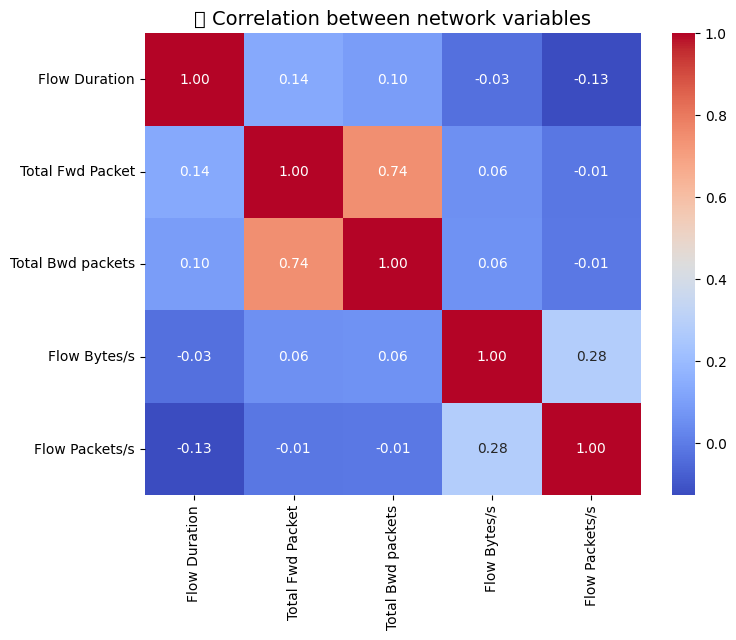

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select some important numerical columns
numeric_cols = ['Flow Duration', 'Total Fwd Packet', 'Total Bwd packets', 'Flow Bytes/s', 'Flow Packets/s']

# Create a correlation matrix
corr = df_small[numeric_cols].corr()

# Draw a heatmap
plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("🔍 Correlation between network variables", fontsize=14)
plt.show()

In [ ]:
import plotly.express as px

# Convert flow duration to seconds
df_small['Flow Duration (s)'] = df_small['Flow Duration'] / 1_000_000

# Organized Boxplot
fig5 = px.box(
    df_small,
    x='Traffic_Type',
    y='Flow Duration (s)',
    title="⏱️ Distribution of flow duration (in seconds) by traffic type",
    color='Traffic_Type'
)

fig5.update_layout(
    xaxis_title="Traffic Type",
    yaxis_title="Flow Duration (seconds)",
    template='plotly_white'
)

fig5.show()

In [ ]:
# Convert Timestamp to datetime
df_small['Timestamp'] = pd.to_datetime(df_small['Timestamp'], errors='coerce')

# Group by time (e.g., each minute)
timeline = df_small.groupby(pd.Grouper(key='Timestamp', freq='1min')).size().reset_index(name='Count')

# Plot the timeline
fig6 = px.line(
    timeline,
    x='Timestamp',
    y='Count',
    title="⏱️ Evolution of traffic volume over time",
    labels={'Count': 'Number of flows', 'Timestamp': 'Time'},
    markers=True
)

fig6.update_layout(template='plotly_dark')
fig6.show()

In [ ]:
from google.colab import files
uploaded = files.upload()



Saving Darknet.csv to Darknet.csv
